# Binary multi armed bandit

### what is it?
The Multi-Armed Bandit problem is the simplest setting of reinforcement learning. Suppose that a gambler faces a row of slot machines (bandits) on a casino. Each one of the $K$ machines has an unknown probability probability distribution $R_i$, and the goal of the player is to pick the which machine to play in order to maximize his long-term cumulative reward.

In a binary (or Bernoulli) multi armed bandit, the probability distribution of each machine is bernoulli, meaning it gives a reward of $1$ or $0$ with a probability $\theta_i$.

### Regret? Goal?

In [1]:
import random as rd
import plotly as py # Ploting library
from scipy.stats import beta # Beta distribution for bayesian inference
import numpy as np # Array storing and manipulation
from Simulator import Simulator # Multi armed bandit simulator base class

py.io.templates.default = "none"

In [2]:
class randomSimulator(Simulator):
    def __init__(self, n_machines, n_iters, probabilities=None, cmap=py.colors.qualitative.D3):
        super().__init__(n_machines, n_iters, probabilities, cmap)
        
    def select_machine(self):
        return rd.randint(0,self.n_machines-1)

In [3]:
class egreedySimulator(Simulator):
    def __init__(self, n_machines, n_iters, epsilon=.2, probabilities=None, cmap=py.colors.qualitative.D3):
        super().__init__(n_machines, n_iters, probabilities, cmap)
        self.epsilon = epsilon
        
    def select_machine(self):
        succ_rate = self.count[:,self.iter,0] / np.sum(self.count[:,self.iter,:], axis=1)
        
        if rd.random() < self.epsilon:
            return rd.randint(0,self.n_machines-1)
        else:
            return np.argmax(succ_rate)
                     

In [4]:
class ThombsonSimulator(Simulator):
    def __init__(self, n_machines, n_iters, epsilon=.2, probabilities=None, cmap=py.colors.qualitative.D3):
        super().__init__(n_machines, n_iters, probabilities, cmap)
        
    def select_machine(self):
        return np.argmax(beta.rvs(a=self.count[:,self.iter,0]+1, b=self.count[:,self.iter,1]+1))

In [5]:
class UCBSimulator(Simulator):
    def __init__(self, n_machines, n_iters, probabilities=None, cmap=py.colors.qualitative.D3):
        super().__init__(n_machines, n_iters, probabilities, cmap)
        
    def select_machine(self):
        
        upperbounds = beta.ppf(1-1/(self.iter+1), a=self.count[:,self.iter,0]+1, b=self.count[:,self.iter,1]+1)
        
        return np.argmax(upperbounds)
    
    def _all_machines_plot(self, n_points=101, frame=None, just_data=False):
        plots = super()._all_machines_plot(n_points, frame, just_data)
        
        for i in range(self.n_machines):
            for j in range(self.n_machines):
                plots.append(py.graph_objs.Scatter(x=[beta.ppf(1-1/(frame+1), a=self.count[i,frame,0]+1, b=self.count[i,frame,1]+1)]*2,
                                                   y=[-1, 2],
                                                   xaxis="x" + str(j+1),
                                                   yaxis="y" + str(j+1),
                                                   mode="lines",
                                                   legendgroup="UCB " + str(i+1),
                                                   name="UCB " + str(i+1),
                                                   showlegend= (j==0),
                                                   line={"color":self.cmap[i]}))
                
        
        return plots
                     

In [6]:
s = ThombsonSimulator(n_machines=4, n_iters=100, probabilities=[.3,.4,.5,.6])

s.simulate()
s.animation()

In [7]:
s = UCBSimulator(n_machines=4, n_iters=100, probabilities=[.3,.4,.5,.6])

s.simulate()
s.animation()

In [8]:
s = egreedySimulator(n_machines=4, n_iters=100, epsilon=.5)

s.simulate()
s.animation()

c:\users\antónio\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:7: RuntimeWarning:

invalid value encountered in true_divide



In [9]:
s = randomSimulator(n_machines=4, n_iters=100)

s.simulate()
s.animation()

In [10]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import tqdm

In [11]:
simulators = [ThombsonSimulator, UCBSimulator]

idxs = []
data = np.array([])
simulator = []

n_iters = 1000

for i in tqdm.tqdm(range(100*len(simulators))):
    sim = simulators[i%len(simulators)]
    s = sim(n_machines=4, n_iters=n_iters)
    
    s.simulate()
    
    idxs += range(n_iters)
    data = np.hstack([data, s.cumulative_regret()])
    simulator += [i%len(simulators)]*n_iters
    
df = pd.DataFrame({"idxs":idxs, "data": data, "simulator":simulator})

100%|██████████████████████████████████████████████████████████████████| 200/200 [00:39<00:00,  5.02it/s]


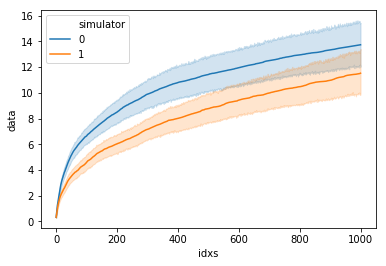

In [12]:
sns.lineplot(x="idxs", y="data", data=df, hue="simulator")

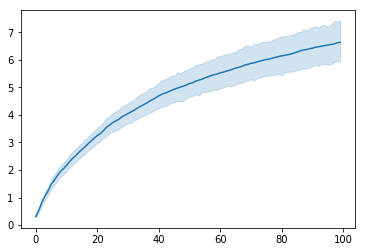

In [13]:
s = ThombsonSimulator(n_machines=4, n_iters=100)

data = []
    
for i in range(100):
    s.simulate()
    data.append(s.cumulative_regret())

sns.lineplot(x=list(range(100))*100, y=np.array(data).flatten())

c:\users\antónio\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:7: RuntimeWarning:

invalid value encountered in true_divide



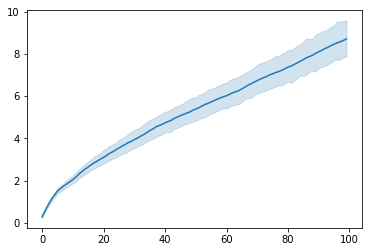

In [14]:
s = egreedySimulator(n_machines=4, n_iters=100)

data = []

for i in range(100):
    s.simulate()
    data.append(s.cumulative_regret())

sns.lineplot(x=list(range(100))*100, y=np.array(data).flatten())

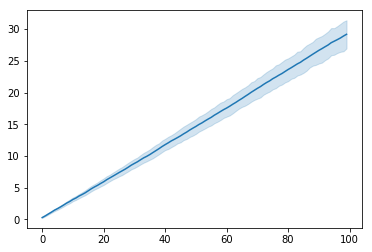

In [15]:
s = randomSimulator(n_machines=4, n_iters=100)

data = []

for i in range(100):
    s.simulate()
    data.append(s.cumulative_regret())

sns.lineplot(x=list(range(100))*100, y=np.array(data).flatten())